In [1]:
import xarray as xr
import altair as alt
import pandas as pd
import datetime
import glob
import sys
sys.path.append('../')
import soslib
import seaborn as sns
import numpy as np

alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

In [2]:
files = glob.glob("/Users/elischwat/Downloads/isfs_*.nc")
files = sorted(files)
files


['/Users/elischwat/Downloads/isfs_20221030.nc',
 '/Users/elischwat/Downloads/isfs_20221031.nc',
 '/Users/elischwat/Downloads/isfs_20221101.nc',
 '/Users/elischwat/Downloads/isfs_20221102.nc',
 '/Users/elischwat/Downloads/isfs_20221103.nc',
 '/Users/elischwat/Downloads/isfs_20221104.nc',
 '/Users/elischwat/Downloads/isfs_20221105.nc',
 '/Users/elischwat/Downloads/isfs_20221106.nc',
 '/Users/elischwat/Downloads/isfs_20221107.nc']

# Create TKE dataframe

In [ ]:
# all variables (covariances) used in calculation of TKE
TKE_VARIABLE_NAMES = [
    ## central tower
    'u_u__1m_c', 'v_v__1m_c', 'w_w__1m_c',
    'u_u__2m_c', 'v_v__2m_c', 'w_w__2m_c',
    'u_u__3m_c', 'v_v__3m_c', 'w_w__3m_c',
    'u_u__5m_c', 'v_v__5m_c', 'w_w__5m_c',
    'u_u__10m_c', 'v_v__10m_c', 'w_w__10m_c',
    'u_u__15m_c', 'v_v__15m_c', 'w_w__15m_c',
    'u_u__20m_c', 'v_v__20m_c', 'w_w__20m_c',
    ## other towers
    'u_u__1m_ue', 'v_v__1m_ue', 'w_w__1m_ue',
    'u_u__3m_ue', 'v_v__3m_ue', 'w_w__3m_ue',
    'u_u__10m_ue', 'v_v__10m_ue', 'w_w__10m_ue',

    'u_u__1m_uw', 'v_v__1m_uw', 'w_w__1m_uw',
    'u_u__3m_uw', 'v_v__3m_uw', 'w_w__3m_uw',
    'u_u__10m_uw', 'v_v__10m_uw', 'w_w__10m_uw',

    'u_u__1m_d', 'v_v__1m_d', 'w_w__1m_d',
    'u_u__3m_d', 'v_v__3m_d', 'w_w__3m_d',
    'u_u__10m_d', 'v_v__10m_d', 'w_w__10m_d',
]

# Convert dataset to dataframe
tke_df = soslib.open_datasets_as_dataframe(files, variables=TKE_VARIABLE_NAMES)

# Parse height and tower information from column names so measurement height and tower is a column
tke_df = tke_df.melt(id_vars='time', value_vars=TKE_VARIABLE_NAMES)
tke_df['height'] = tke_df['variable'].apply(soslib.height_from_variable_name)
tke_df['tower'] = tke_df['variable'].apply(soslib.tower_from_variable_name)
tke_df['measurement'] = tke_df['variable'].apply(soslib.measurement_from_variable_name)
tke_df = tke_df.set_index(['time'])

# Calculate TKE
tke_df = tke_df.groupby(['time', 'height', 'tower']).sum(numeric_only=True).reset_index()
tke_df['value'] = 0.5*tke_df['value']

## Create height & time bounds for 2D colormap plotting of TKE

In [ ]:
def height_to_bounds(h):
    if h == 1:
        return (0,1)
    if h == 2:
        return (1,2)
    elif h == 3:
        return (2, 4)
    elif h == 5:
        return (4, 7)
    elif h == 10:
        return (7, 13)
    elif h == 15:
        return (13, 17)
    elif h == 20:
        return (17, 23)
tke_df['height_bounds'] = tke_df['height'].apply(height_to_bounds)
tke_df['height1'] = tke_df['height_bounds'].apply(lambda x: x[0])
tke_df['height2'] = tke_df['height_bounds'].apply(lambda x: x[1])



tke_df['time2'] = tke_df['time'].apply(lambda t: t + datetime.timedelta(minutes = 5))

# Examine TKE

### Distribution of values

/var/folders/jy/xv6qnlms2cj_3p5yrzcwc0n00000gn/T/ipykernel_87791/3377503637.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  ax = sns.distplot(


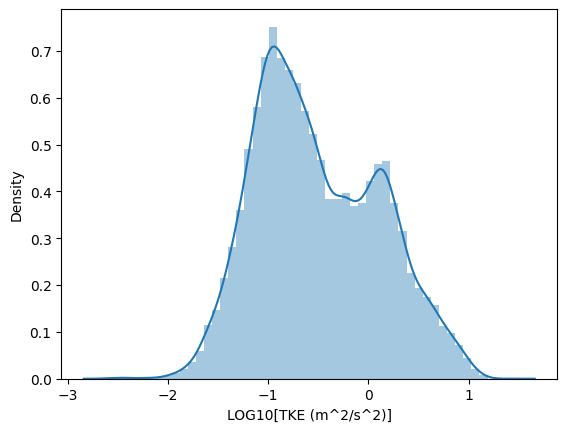

In [26]:
ax = sns.distplot(
    np.log10([f for f in tke_df['value'] if f != 0]),
    axlabel='LOG10[TKE (m^2/s^2)]', 
    norm_hist=True
)

### Characteristic vertical profiles at 1am amd 1pm

In [39]:
plot = None
for i in range(1, 6):
    local_src = tke_df[tke_df['time'].dt.day == i]
    local_src = local_src[local_src['time'].dt.hour == 1]
    local_src = local_src.groupby(['height', 'tower']).mean().reset_index()
    new_chart = alt.Chart(local_src).mark_line().encode(
            alt.X('value:Q', title='TKE (m^2/s^2)', sort='y', scale=alt.Scale(zero=True)),
            alt.Y('height', title='Height (m)'),
            alt.Color('tower:N')
        ).properties(width=100, title=f'1-2am on November {i}')
    if i == 1:
        plot = new_chart
    else:
        plot = plot | new_chart
plot

/var/folders/jy/xv6qnlms2cj_3p5yrzcwc0n00000gn/T/ipykernel_87791/3220713626.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  local_src = local_src.groupby(['height', 'tower']).mean().reset_index()
/var/folders/jy/xv6qnlms2cj_3p5yrzcwc0n00000gn/T/ipykernel_87791/3220713626.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  local_src = local_src.groupby(['height', 'tower']).mean().reset_index()
/var/folders/jy/xv6qnlms2cj_3p5yrzcwc0n00000gn/T/ipykernel_87791/3220713626.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will defa

alt.HConcatChart(...)

In [40]:
plot = None
for i in range(1, 6):
    local_src = tke_df[tke_df['time'].dt.day == i]
    local_src = local_src[local_src['time'].dt.hour == 13]
    local_src = local_src.groupby(['height', 'tower']).mean().reset_index()
    new_chart = alt.Chart(local_src).mark_line().encode(
            alt.X('value:Q', title='TKE (m^2/s^2)', sort='y', scale=alt.Scale(zero=True)),
            alt.Y('height', title='Height (m)'),
            alt.Color('tower:N')
        ).properties(width=100, title=f'1-2pm on November {i}')
    if i == 1:
        plot = new_chart
    else:
        plot = plot | new_chart
plot

/var/folders/jy/xv6qnlms2cj_3p5yrzcwc0n00000gn/T/ipykernel_87791/3891617835.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  local_src = local_src.groupby(['height', 'tower']).mean().reset_index()
/var/folders/jy/xv6qnlms2cj_3p5yrzcwc0n00000gn/T/ipykernel_87791/3891617835.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  local_src = local_src.groupby(['height', 'tower']).mean().reset_index()
/var/folders/jy/xv6qnlms2cj_3p5yrzcwc0n00000gn/T/ipykernel_87791/3891617835.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will defa

alt.HConcatChart(...)

### Temporal evolution of vertical profile

In [36]:
local_src = tke_df.copy()
local_src['time'] = local_src['time'] - datetime.timedelta(hours = 6)
local_src['time2'] = local_src['time2'] - datetime.timedelta(hours = 6)
plot_tke_tower_c = alt.Chart(local_src).transform_filter(
    alt.datum.tower=='c'
).mark_rect().encode(
    alt.X('time:T', title='Time'),
    alt.X2('time2:T'),
    alt.Y('height1:Q', title='Height (m)'),
    alt.Y2('height2:Q'),
    alt.Color('value:Q', scale=alt.Scale(domain=[0.01,10], type='log'), title='TKE'),
    alt.Facet('tower:N', columns=1)
).properties(width=1400)

plot_tke_tower_c

alt.Chart(...)

# Create covariance dataframe

In [41]:
COVARIANCE_VARIABLE_NAMES = ['u_u__5m_c', 'v_v__5m_c', 'w_w__5m_c']
variances_df = soslib.open_datasets_as_dataframe(files, variables=COVARIANCE_VARIABLE_NAMES)
variances_df = variances_df.melt(id_vars='time', value_vars=COVARIANCE_VARIABLE_NAMES)
variances_df['height'] = variances_df['variable'].apply(soslib.height_from_variable_name)
variances_df['tower'] = variances_df['variable'].apply(soslib.tower_from_variable_name)
variances_df['measurement'] = variances_df['variable'].apply(soslib.measurement_from_variable_name)

# Examine Covariances

### Temporal evolution @ 5 meters, tower C

In [42]:
local_src = variances_df[variances_df['time'] < datetime.datetime(2022, 11, 7)]
local_src = local_src[local_src['time'] > datetime.datetime(2022, 11, 3)]
alt.Chart(local_src).mark_line().encode(
    alt.X('time:T'),
    alt.Y('value:Q'),
    alt.Color('variable:N')
).properties(width=1300)

/Users/elischwat/miniconda3/envs/arm/lib/python3.9/site-packages/altair/utils/core.py:317: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for col_name, dtype in df.dtypes.iteritems():


alt.Chart(...)

# Create wind speed and direction dataframe

In [43]:
WIND_VARIABLE_NAMES = [    
    'spd_1m_c', 'dir_1m_c',
    'spd_2m_c', 'dir_2m_c',
    'spd_3m_c', 'dir_3m_c',
    'spd_5m_c', 'dir_5m_c',
    'spd_10m_c', 'dir_10m_c',
    'spd_15m_c', 'dir_15m_c',
    'spd_20m_c', 'dir_20m_c',
]

wind_df = soslib.open_datasets_as_dataframe(files, variables=WIND_VARIABLE_NAMES)

wind_df = wind_df.melt(id_vars='time', value_vars=WIND_VARIABLE_NAMES)
wind_df['height'] = wind_df['variable'].apply(soslib.height_from_variable_name)
wind_df['tower'] = wind_df['variable'].apply(soslib.tower_from_variable_name)
wind_df['measurement'] = wind_df['variable'].apply(soslib.measurement_from_variable_name)

### Pivot table to have wind speed and direction as different columns

In [44]:
wind_df = wind_df.pivot_table(
   values = ['value'],
   index= ['time', 'height', 'tower'],
   columns= ['measurement']
)
wind_df.columns = wind_df.columns.get_level_values(1)
wind_df = wind_df.reset_index()
wind_df = wind_df.sort_values(['time', 'height', 'tower'])
wind_df.columns.name = None

### Resample by 30 minute intervals

In [60]:
wind_30min_df = wind_df.set_index('time')
grouper = wind_30min_df.groupby([pd.Grouper(freq='30T'), 'height', 'tower'])


result = grouper.mean()

# result = grouper[['wind direction', 'wind speed']].mean().unstack()
result.columns = result.columns.get_level_values(0)
wind_30min_df = result.reset_index()

### Resample by 60 minute intervals

In [96]:
wind_60min_df = wind_df.set_index('time')
grouper = wind_60min_df.groupby([pd.Grouper(freq='60T'), 'height', 'tower'])


result = grouper.mean()

# result = grouper[['wind direction', 'wind speed']].mean().unstack()
result.columns = result.columns.get_level_values(0)
wind_60min_df = result.reset_index()

# Examine wind speed and direction

In [62]:
plot_windspeed_tower_c = alt.Chart(wind_30min_df).transform_filter(
    alt.datum.height == 5
).mark_point().encode(
    alt.X('time:T'),
    alt.Y('wind speed:Q'),
    alt.Color('height:N')
).properties(width=1400)

plot_tke_tower_c & plot_windspeed_tower_c

/Users/elischwat/miniconda3/envs/arm/lib/python3.9/site-packages/altair/utils/core.py:317: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for col_name, dtype in df.dtypes.iteritems():


alt.VConcatChart(...)

In [47]:
plot_windspeed_tower_c = alt.Chart(wind_30min_df).transform_filter(
    alt.datum.height == 5
).mark_point().encode(
    alt.X('time:T'),
    alt.Y('wind speed:Q'),
    alt.Color('height:N')
).properties(width=1400)

plot_tke_tower_c & plot_windspeed_tower_c

/Users/elischwat/miniconda3/envs/arm/lib/python3.9/site-packages/altair/utils/core.py:317: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for col_name, dtype in df.dtypes.iteritems():


alt.VConcatChart(...)

In [143]:
pd.set_option('display.max_rows', 500)

In [144]:
local_src[local_src['time'].dt.day==2].head(100)

,time,height,tower,wind direction,wind speed,day,hour
546,2022-11-02 00:00:00,1,c,326.756134,1.524163,2022-11-02,0
547,2022-11-02 00:00:00,2,c,324.414276,1.856598,2022-11-02,0
548,2022-11-02 00:00:00,3,c,318.589691,2.027997,2022-11-02,0
549,2022-11-02 00:00:00,5,c,314.647949,2.151556,2022-11-02,0
550,2022-11-02 00:00:00,10,c,306.007538,2.152358,2022-11-02,0
551,2022-11-02 00:00:00,15,c,276.203186,2.076190,2022-11-02,0
552,2022-11-02 00:00:00,20,c,276.896088,1.829303,2022-11-02,0
553,2022-11-02 01:00:00,1,c,318.206390,1.486632,2022-11-02,1
554,2022-11-02 01:00:00,2,c,318.493439,1.753031,2022-11-02,1
555,2022-11-02 01:00:00,3,c,314.228668,1.874291,2022-11-02,1


In [147]:
local_src = wind_60min_df.copy()
local_src['time'] = local_src['time'] - datetime.timedelta(hours = 6)
local_src['day'] = local_src['time'].dt.date.apply(lambda date: datetime.datetime.combine(date, datetime.time()))
local_src['hour'] = local_src['time'].dt.hour

local_src = local_src[local_src['time'] < datetime.datetime(2022, 11, 4)]
alt.Chart(local_src).mark_point(shape="wedge", filled=True).encode(
    alt.X('hour:Q'),
    alt.Y('height:Q'),
    # color=alt.Color(
    #     "wind direction", scale=alt.Scale(domain=[0, 360], scheme="rainbow"), legend=None
    # ),
    angle=alt.Angle("wind direction", scale=alt.Scale(domain=[0, 360], range=[180, 540])),
    size=alt.Size("wind speed", scale=alt.Scale(rangeMax=5000), title='Wind Speed (m/s)'),
).properties(
    width=1000,
    height=200
).facet(
    row='day:T'
)

/Users/elischwat/miniconda3/envs/arm/lib/python3.9/site-packages/altair/utils/core.py:317: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for col_name, dtype in df.dtypes.iteritems():


alt.FacetChart(...)

### Animated video of 5 minute wind interval

In [107]:
src = wind_30min_df.query("tower == 'c'")

#### For each time interval, add a 0 wind speed at 0 height with direction 0

In [108]:
for time in src.time.unique():
    src = src.append(
        {
            'height': 0,
            'time': time,
            'wind speed': 0
        },
        ignore_index=True
    )

/var/folders/jy/xv6qnlms2cj_3p5yrzcwc0n00000gn/T/ipykernel_87791/1537958345.py:2: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  src = src.append(
/var/folders/jy/xv6qnlms2cj_3p5yrzcwc0n00000gn/T/ipykernel_87791/1537958345.py:2: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  src = src.append(
/var/folders/jy/xv6qnlms2cj_3p5yrzcwc0n00000gn/T/ipykernel_87791/1537958345.py:2: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  src = src.append(
/var/folders/jy/xv6qnlms2cj_3p5yrzcwc0n00000gn/T/ipykernel_87791/1537958345.py:2: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  src = src.append(
/var/folders/jy/xv6qnlms2cj_3p5yrzcwc0n00000gn/T/ipykernel_8

In [109]:
dataset = src.sort_values(['time', 'height']).copy()

dt = 5 # minutes
tfinal = 24*60 # 24 hours
x0 = 0

dataset_chunk_size = 8 # number of measurements to take at a time  from the dataframe

In [110]:
i = 1

In [111]:
dataset[ i*dataset_chunk_size : (i+1)*dataset_chunk_size]

,time,height,tower,wind direction,wind speed,day
2588,2022-10-30 00:30:00,0,NaN,NaN,0.000000,NaN
7,2022-10-30 00:30:00,1,c,300.768677,3.232679,303.0
8,2022-10-30 00:30:00,2,c,300.955505,3.755829,303.0
9,2022-10-30 00:30:00,3,c,298.947601,4.170544,303.0
10,2022-10-30 00:30:00,5,c,299.514099,4.772872,303.0
11,2022-10-30 00:30:00,10,c,294.460815,5.527431,303.0
12,2022-10-30 00:30:00,15,c,293.192780,5.659266,303.0
13,2022-10-30 00:30:00,20,c,289.140015,5.481658,303.0


In [112]:
dataset.sort_values('wind speed').tail(100)

,time,height,tower,wind direction,wind speed,day
1988,2022-11-05 01:30:00,3,c,304.695648,7.691103,309.0
1929,2022-11-04 21:00:00,10,c,303.363861,7.695927,308.0
2033,2022-11-05 04:30:00,15,c,298.552216,7.784889,309.0
2062,2022-11-05 06:30:00,20,c,297.758240,7.800740,309.0
1913,2022-11-04 19:30:00,20,c,307.347321,7.801683,308.0
...,...,...,...,...,...,...
2334,2022-11-06 02:00:00,15,c,338.738556,12.915662,310.0
2327,2022-11-06 01:30:00,15,c,323.514893,12.926330,310.0
2325,2022-11-06 01:30:00,5,c,319.534454,13.216166,310.0
2335,2022-11-06 02:00:00,20,c,337.440704,13.332156,310.0


MovieWriter ffmpeg unavailable; using Pillow instead.


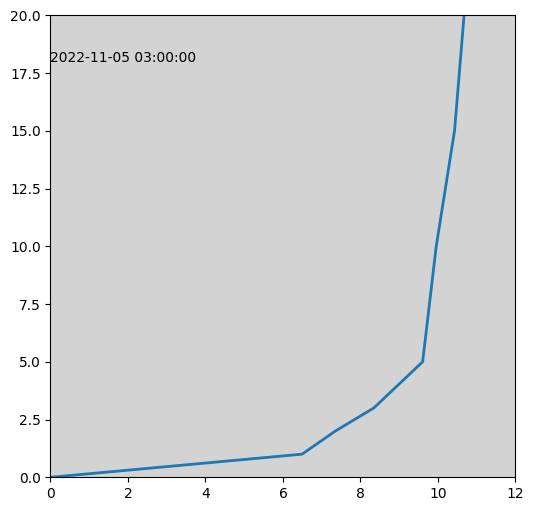

In [135]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation

fig, ax = plt.subplots(1, 1, figsize = (6, 6))

def animate(i):
    ax.cla() # clear the previous image
    chunk = dataset[ i*dataset_chunk_size : (i+1)*dataset_chunk_size].sort_values('height')
    ax.plot(chunk['wind speed'], chunk['height'], linewidth=2) # plot the line
    ax.set_xlim([0, 12])
    ax.set_ylim(0, 20)
    ax.annotate(str(chunk.iloc[0].time), xy=(0, 18))
    hr = chunk.iloc[0].time.hour 
    if hr < 6 or hr > 18:
        ax.patch.set_facecolor('lightgrey')
    else:
        ax.patch.set_facecolor('white')


anim = animation.FuncAnimation(fig, animate, frames = range(0, int(tfinal / dt)), blit = False, interval=50)
anim.save('test.gif')

plt.show()

# TKE Budget

## Simplified TKE Equation

Assumptions for simplified TKE equation:
* Coordinate system  is aligned with the mean wind so that terms involving v are zero, 
* Applied over a flat, homogeneous area with no subsidence so that terms involving (∂/∂x), (∂/∂y) and w are also zero


$$
\frac{\partial \overline{e}}{\partial t} = g \frac{\overline{w'\theta_v'}}{\overline{\theta_v}} - \frac{1}{\rho_a}\frac{\partial \overline{w'P'}}{\partial z} - \overline{u'w'} \frac{\partial \overline{u}}{\partial z} - \frac{\partial \overline{w' e}}{\partial z} - \epsilon
$$

$$
\Delta \text{TKE} = \text{term 2} + \text{term 3} + \text{term 4} + \text{term 5} + \text{term 6}
$$
where

$$
\epsilon = \nu 
    \Big(
        \overline { 
            \frac{\partial \overline{u'}}{\partial x}^2
        }
    +
        \overline { 
            \frac{\partial \overline{v'}}{\partial x}^2
        }
    +
        \overline { 
            \frac{\partial \overline{w'}}{\partial x}^2
        }
    \Big)
$$
where:

term 1: temporal change in local TKE

term 2: bouyant production or destribution of TKE

term 3: redistribution of TKE by pressure fluctuations

term 4: shear/friction production of turbulence

term 5: turbulent transport of TKE

term 6: viscous dissipation of TKE